In [1]:
import numpy as np
import scipy.io as spio    # 1.0.0
import scipy.signal as spsig
from matplotlib import cm
import imageio
from skimage import io
from skimage.feature import plot_matches
import sys
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt
import matplotlib

# Part 1: preparation 

## reading files in a loop

In [2]:
mypath = './group2/'
"""input complex data is stored in a dictionary """
onlyfiles = [ f for f in listdir(mypath) if isfile(join(mypath,f)) ]
images = np.empty(len(onlyfiles), dtype=object)


for n in range(0, len(onlyfiles)):
    images[n] = spio.loadmat( join(mypath,onlyfiles[n]) )

## compute amplitude

In [3]:
amplitude = np.empty((4001,13001,15),dtype=np.float32)

for m in range(15):
    #temp = np.absolute((images[m]['image_asc_crp']))
    #amplitude = np.dstack((amplitude, temp))
    amplitude[:,:,m] = np.absolute((images[m]['image_asc_crp'])) # clean and faster version

# Part 2: Structural spatial filtering

## part 2.1 compute spatial average 

### generate average image

In [4]:
from numba import jit

@jit(nopython=True)
def average(images):
    """average image is computed by a pixel-wise averaging the values through the stack """
    r,c,n = images.shape
   
    #averaged_image = np.empty([r,c],dtype=float) # not supported feature for numba
    averaged_image = np.zeros((r,c),dtype=np.float32)
        
    for i in range (r):
        for j in range (c):

            averaged_image[i,j] = np.mean(images[i,j,:])
        
    return averaged_image

In [5]:
averaged_image = average(amplitude)

### prepare 8 edge aligned structure windows

In [6]:
Mask = np.zeros((5,5,0),dtype=np.float32)

mask_0 = np.array([[1/15, 1/15, 1/15, 1/15, 1/15],[1/15, 1/15, 1/15, 1/15, 0],[1/15, 1/15, 1/15, 0, 0],[1/15, 1/15, 0, 0, 0],[1/15, 0, 0, 0,0]])
Mask = np.dstack((Mask,mask_0))

mask_1 = np.array([[1/15, 1/15, 1/15, 1/15, 1/15],[1/15, 1/15, 1/15, 1/15, 1/15],[1/15, 1/15, 1/15, 1/15, 1/15],[0,0,0,0,0],[0,0,0,0,0]])
Mask = np.dstack((Mask,mask_1))

mask_2 = np.array([[1/15, 1/15, 1/15, 1/15, 1/15],[0,1/15, 1/15, 1/15, 1/15],[0,0,1/15, 1/15, 1/15],[0,0,0,1/15, 1/15],[0,0,0,0,1/15]])
Mask = np.dstack((Mask,mask_2))

mask_3 = np.array([[1/15,1/15,1/15,0,0],[1/15,1/15,1/15,0,0],[1/15,1/15,1/15,0,0],[1/15,1/15,1/15,0,0],[1/15,1/15,1/15,0,0]])
Mask = np.dstack((Mask,mask_3))

mask_4 = np.zeros((5,5),dtype=np.float32)
Mask = np.dstack((Mask,mask_4))

mask_5 = np.array([[0,0,1/15,1/15,1/15],[0,0,1/15,1/15,1/15],[0,0,1/15,1/15,1/15],[0,0,1/15,1/15,1/15],[0,0,1/15,1/15,1/15]])
Mask = np.dstack((Mask,mask_5))

mask_6 = np.array([[1/15,0,0,0,0],[1/15,1/15,0,0,0],[1/15,1/15,1/15,0,0],[1/15,1/15,1/15,1/15,0],[1/15,1/15,1/15,1/15,1/15]])
Mask = np.dstack((Mask,mask_6))

mask_7 = np.array([[0,0,0,0,0],[0,0,0,0,0],[1/15, 1/15, 1/15, 1/15, 1/15],[1/15, 1/15, 1/15, 1/15, 1/15],[1/15, 1/15, 1/15, 1/15, 1/15]])
Mask = np.dstack((Mask,mask_7))

mask_8 = np.array([[0,0,0,0,1/15],[0,0,0,1/15,1/15],[0,0,1/15,1/15,1/15],[0,1/15,1/15,1/15,1/15],[1/15, 1/15, 1/15, 1/15, 1/15]])
Mask = np.dstack((Mask,mask_8))
#print(Mask.shape)

### compute spatial average

In [7]:
@jit(nopython=True)
def spatial_average(Mask,images):
    r,c = images.shape

    #initialize array
    spatial_average = np.empty((r,c),dtype=np.float32)
    
    """searching window """
    #define window dimension for estimation
        
    w_rw = 5 
    w_cl = 5
        
    #define starting and end point in data for sliding window
    rw_stt = np.int( np.ceil(w_rw/2.) ) #ceil for defining largest integer 
    #print('starting row indx',rw_stt)
    
    cl_stt = np.int( np.ceil(w_cl/2.) )
    #print('starting column indx',cl_stt)
    
    rw_stp = np.int( r - np.floor(w_rw/2.) ) # floor for defining smallest integer
    #print('ending row indx',rw_stp)
    
    cl_stp = np.int( c - np.floor(w_cl/2.) )
    #print('ending column indx',cl_stp)
        
       
    for rr in range(rw_stt,rw_stp+1): # serach window row wise
        #define extent of window
        #print('iteration in row',rr)
        from_rw = np.int( rr - np.ceil(w_rw/2.) ) # starts from indx=0
        #print('slide from the row indx of',from_rw)
        
        to_rw = np.int( rr + np.floor(w_rw/2.))
        #print('slide to the row indx of',to_rw)
            
        for cc in range(cl_stt, cl_stp+1):#search window colunm wise
            #define extent of window
            #print('iteration in column',cc)
            
            from_cl = np.int( cc - np.ceil(w_cl/2.) ) 
            #print('slide from the column indx of',from_cl)
            
            to_cl = np.int( cc + np.floor(w_cl/2.))
            #print('slide to the column indx of',to_cl)
                
            subview = images[from_rw:to_rw,from_cl:to_cl]
            #print('selected windows',subview)
            
            """downsampling search window into 9 3x3 subares and compute mean of them"""
            submeans = np.zeros((9,), dtype=np.float32)
            for i in range(3):
                for j in range(3):
                    submeans[i*3+j] = np.mean(subview[i:i+3,j:j+3])
             
            #print('submeans',submeans)
            """compare the submeans with respect to middle mean"""
            middle = submeans[4]
            distances = np.abs(submeans - middle)
            distances[4] = np.max(distances)+1
            idx = np.argmin(distances) 
            #print('position of closest submean',idx)
            
            """select corresponding structure window"""
            filter_mask = Mask[:,:,np.int(idx)]
            #print('selected mask',filter_mask)
            
            """ convolve with structure window"""
            #print(np.multiply(subview,filter_mask))
            spatial_average[rr,cc] = np.sum(np.multiply(subview,filter_mask))
            
    return spatial_average

In [8]:
spatial_averaged_image = spatial_average(Mask,averaged_image)

## part 2.2 compute equivalent number of looks
\begin{equation*}L = \sqrt{{\frac{mean}{stdev}}}\end{equation*}

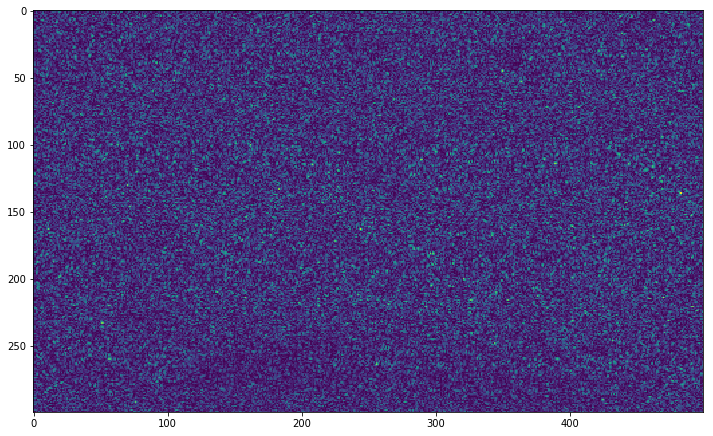

In [9]:
matplotlib.rcParams['figure.figsize'] = [12,12]
plt.imshow(amplitude[1400:1700,6200:6700,0]) # HR in the center of deformation area
plt.show()

In [10]:
HR = amplitude[1400:1700,6200:6700,:]
L = np.sqrt(np.mean(HR)/np.std(HR))
print(L) 

1.0114669


## part 2.3 choose the estimated standard deviation of the input amplitude

In [11]:
#sigma = 0.8
#sigma = 0.6 
#sigma = 0.5 
#sigma = 0.361078
sigma = 0.305303

## part 2.4 compute the weight and local mean backscattering coefficients
\begin{equation*}b=\frac{L}{L+1}{(1-\frac{\bar I_{i,j}^{2}}{L\sigma_{i,j}^ {2}})}\end{equation*}

\begin{equation*}I_{i,j} = (1-b)\bar I_{i,j} + bI_{i,j}\end{equation*}

In [12]:
@jit(nopython=True)

def Lee_filter(L,sigma,amplitude,spatial_average):
    r,c = spatial_average.shape
    spatial_filtered_image = np.empty((r,c),dtype=np.float32)
    for i in range(r):
        for j in range(c):
            b = (L/(L+1))*(1-((spatial_average[i,j]**2)/L*(sigma)**2))
            if b < 0:
                b = 0
            spatial_filtered_image[i,j] = (1-b)*spatial_average[i,j] + b*amplitude[i,j]    
    return spatial_filtered_image

In [13]:
local_mean_backscattering_coefficients = np.empty((4001,13001,15),dtype=np.float32)
for i in range(15):
    local_mean_backscattering_coefficients[:,:,i] = Lee_filter(L,sigma,amplitude[:,:,i],spatial_averaged_image)

# Part 3: multi-temporal filtering
\begin{equation*}J_{i} = \frac{\bar I_{i}}{M}\sum_{j=0}^{M} \frac{I_{j}}{\bar I_{j}}\end{equation*}
\begin{equation*} {1}\le{M}\le{m}\end{equation*}

In [14]:
@jit(nopython=True)
def multi_temporal_filter(amplitude,coefficient):
    r,c,d = amplitude.shape
    result = np.empty((r,c,d),dtype=np.float32)
    M = 15 
    
    for n in range(d):
        for i in range(r):
            for j in range(c):
                result[i,j,n]=((1/M)*coefficient[i,j,n])*np.sum((1/coefficient[i,j,:])*(amplitude[i,j,:]))
        
    return result

In [15]:
filtered_amplitude = multi_temporal_filter(amplitude,local_mean_backscattering_coefficients)

# Part 4: visualization

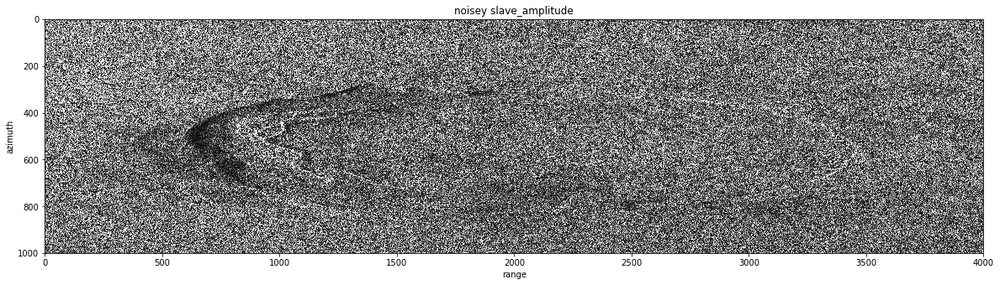

In [47]:
#Path = './clean image/slave_noisy.jpeg' 
matplotlib.rcParams['figure.figsize'] = [20,15]
plt.imshow(amplitude[1000:2000,4200:8200,0],cmap=cm.gray, vmin=0, vmax=2800)
plt.xlabel('range')
plt.ylabel('azimuth')
plt.title('noisy slave_amplitude')
#plt.savefig(Path) 
plt.show()

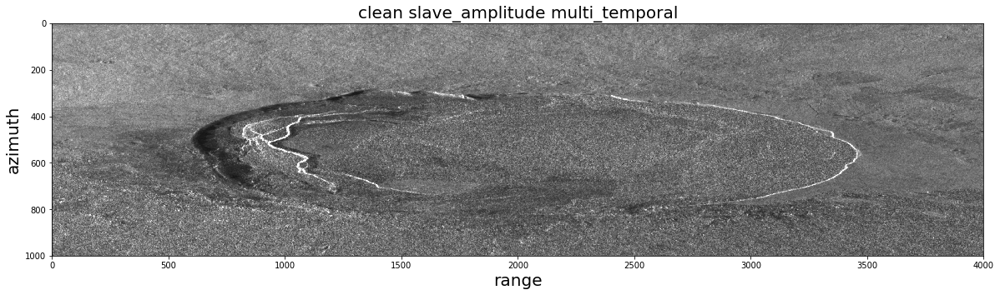

In [49]:
#Path = './clean image/slave_clean_multi_temporal.jpeg' 
matplotlib.rcParams['figure.figsize'] = [20,15]
plt.imshow(local_mean_backscattering_coefficients[1000:2000,4200:8200,0],cmap=cm.gray, vmin=0, vmax=2800)
plt.xlabel('range',fontsize=20)
plt.ylabel('azimuth',fontsize=20)
plt.title('clean slave_amplitude multi_temporal',fontsize=20)
#plt.savefig(Path) 
plt.show()

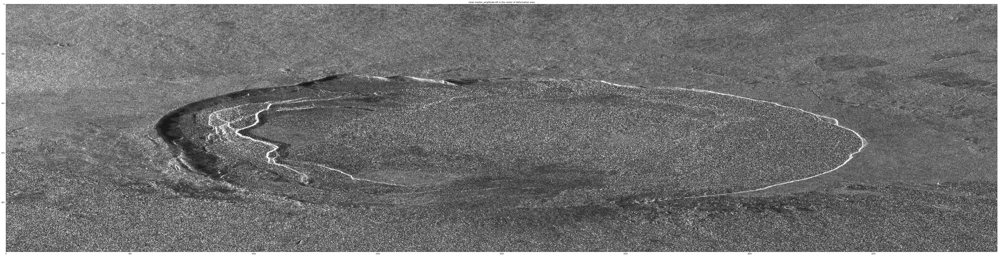

In [17]:
matplotlib.rcParams['figure.figsize'] = [100,100]
plt.imshow(filtered_amplitude[1000:2000,4200:8200,14],cmap=cm.gray, vmin=0, vmax=2800)
plt.title('clean master_amplitude:HR in the center of deformation area')
plt.show()

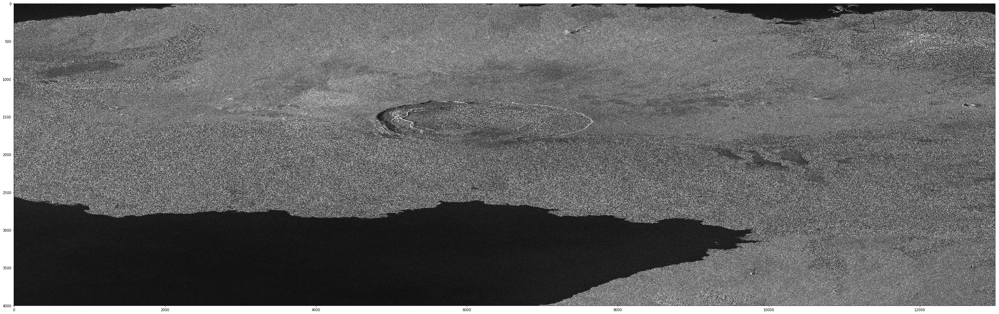

In [18]:
matplotlib.rcParams['figure.figsize'] = [50,50]
plt.imshow(filtered_amplitude[:,:,14],cmap=cm.gray, vmin=0, vmax=2800)
plt.show()

# Part 5: intermediate result control
\begin{equation*}L = \sqrt{{\frac{mean}{stdev}}}\end{equation*}

In [16]:
from numpy import *

where_are_NaNs = isnan(filtered_amplitude)
filtered_amplitude[where_are_NaNs] = 0

HR_new = filtered_amplitude[1400:1700,6200:6700,:]
#HR_new = filtered_amplitude[1250:2000,:2000,:] 
L_new = np.sqrt(np.mean(HR_new)/np.std(HR_new))
print((L_new)) 

1.4331461


In [17]:
#imageio.imsave('master_test_anotherDate.tiff',filtered_amplitude[:,:,14])
imageio.imsave('slave_test_anotherDate.tiff',filtered_amplitude[:,:,1])
#imageio.imwrite('astronaut-gray.jpg', im[:, :, 0])